In [114]:
import cv2
import numpy as np
from PIL import Image

IMAGE_DIR_PATH = r'C:\Users\Krul\Documents\GitHub\cell-painting-dashboard\data\processed\HepG2_Exp3_Plate1_FX9__2021-04-08T16_16_48'
images =['r01c01f01p01-ch1sk1fk1fl1.tiff', 'r01c01f01p01-ch2sk1fk1fl1.tiff', 'r01c01f01p01-ch3sk1fk1fl1.tiff', 'r01c01f01p01-ch4sk1fk1fl1.tiff']


In [115]:
def merge_images(values):
    result_image = np.zeros((1080, 1080))
    num_of_images = len(values)
    
    for value in values:
        image_channel = cv2.imread(IMAGE_DIR_PATH  + '/' + images[value-1],
                                   cv2.COLOR_RGB2BGR)
        result_image += image_channel / num_of_images
    return result_image


In [140]:
def merge_images2(values, v):
    c = []
    for value in values:
        c.append(Image.fromarray(cv2.imread(IMAGE_DIR_PATH  + '/' + images[value-1],
                                   cv2.IMREAD_GRAYSCALE)))
    for i in [1,2,3,4]:
        if i not in values:
            c.append(Image.fromarray(np.ones((1080, 1080), dtype=np.uint8)))
    image = Image.merge("CMYK", (c[0], c[1], c[2], c[3]))
    image = np.array(image.convert('RGB'))
    return image
            
            

In [141]:
img = merge_images([3])

In [142]:
img2 = merge_images2([1,2, 3, 4], 1)
np.max(img2)

255

In [143]:
import plotly.express as px
fig = px.imshow(img, color_continuous_scale='gray')
fig.update_layout(width=400, height=400, margin=dict(l=10, r=10, b=10, t=10))
fig.show()


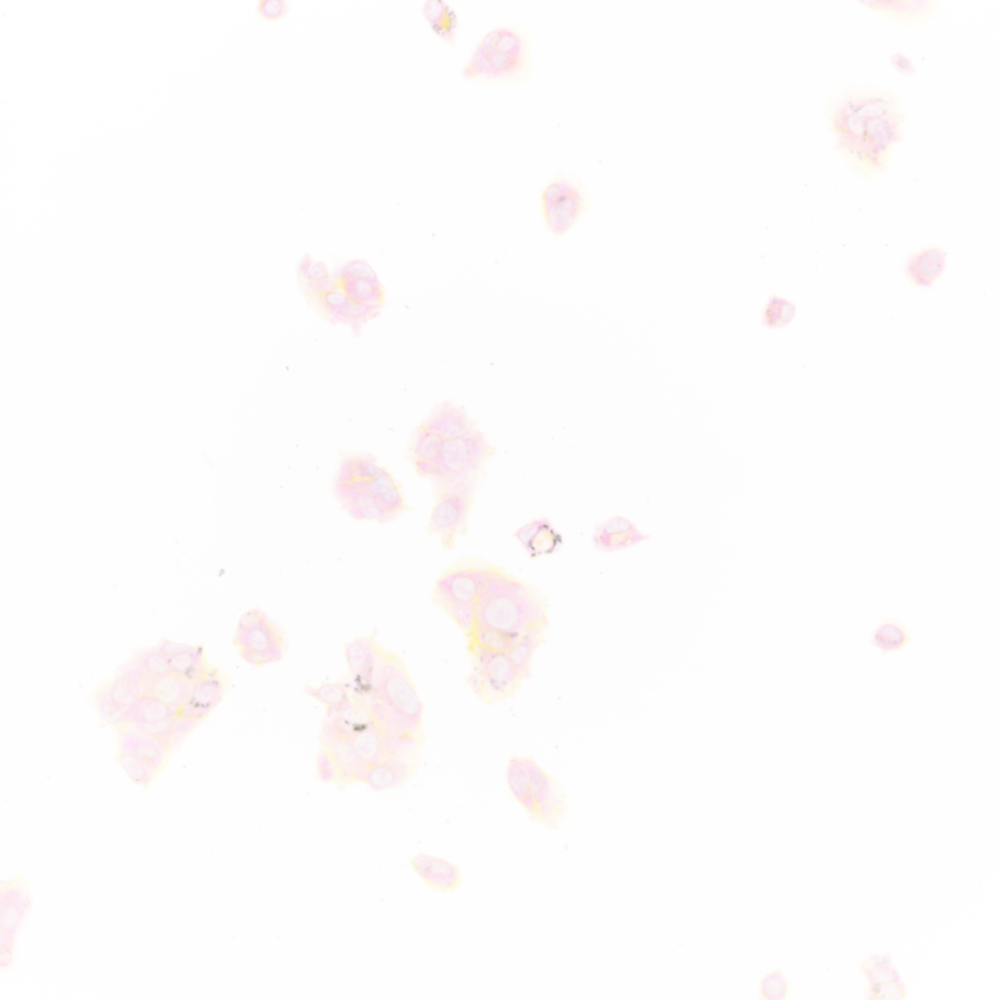

In [144]:
import plotly.express as px
fig = px.imshow(img2)
fig.update_layout(width=400, height=400, margin=dict(l=10, r=10, b=10, t=10))
fig.show()

In [97]:
np.max(cv2.imread(IMAGE_DIR_PATH  + '/' + images[3],
                                   cv2.COLOR_RGB2BGR))

95